In [7]:
import numpy as np
import pandas as pd
import os
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score, davies_bouldin_score, pairwise_distances
from sklearn.neighbors import KNeighborsRegressor, NearestNeighbors, KernelDensity
# %matplotlib notebook
import matplotlib.pyplot as plt
from itertools import combinations
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from mpl_toolkits.mplot3d import Axes3D 
import multiprocessing
from joblib import Parallel, delayed
from utils import filter_paths

In [8]:
def apply_tsne(tsne, data):
    data_transformed = tsne.fit_transform(data)
    return tsne, data_transformed

In [9]:
datasets_nums = {'AGP':9511, 'ptb':3457, 't2d':1044, 'ibd':86}
color = {'AGP':'red', 'ptb':'green', 't2d':'blue', 'ibd':'purple'}

N = sum([i for i in datasets_nums.values()])
datasets_colors = np.zeros(N).astype(str)
dataset_names = np.zeros(N).astype(str)
i_, i_prev = 0, 0
for k,v in datasets_nums.items():
    datasets_colors[i_prev:i_prev+v] = color[k]
    dataset_names[i_prev:i_prev+v] = k
    i_ += 1
    i_prev += v

# Merged

In [10]:
root_merged = './merged_datasets_proj/'
paths_merged = [os.path.join(root_merged,path) for path in os.listdir(root_merged)]
label2path = {}
datasets_merged = {}
for path in paths_merged:
    label = path.split('/')[-1].split('.')[0]
    label2path[label] = path
    datasets_merged[label] = np.genfromtxt(path, delimiter=';')

In [11]:
# load data
root_tsne = 'merged_datasets_transformed'
paths_tsne = filter_paths([os.path.join(root_tsne,path) for path in os.listdir(root_tsne)], keywords=['tsne'])
data_transformed3d_merged = { p.split('/')[-1].split('.')[0]:np.load(p, allow_pickle=True) for p in paths_tsne}

In [12]:
# tsne3d = TSNE(n_components=3, init='pca', verbose=0, angle=0.3, perplexity=50, n_iter=5000, random_state=42)
# results3d_merged = Parallel(n_jobs=-1)(delayed(apply_tsne)(tsne3d, data) for _, data in datasets_merged.items())  
# data_transformed3d_merged = dict(zip(datasets_merged.keys(), [result[1] for result in results3d_merged]))

In [13]:
SAVE_MERGED = False

if SAVE_MERGED:
    for k,v in zip( datasets_merged.keys(), data_transformed3d_merged):
        np.save(f'./merged_datasets_transformed/{k}_tsne3d', v)

# 3D plotly

In [14]:
# # Initialize figure with 4 3D subplots
# fig = make_subplots(
#     rows=1, 
#     cols=3,
#     specs=[[{'type': 'scene'}, {'type': 'scene'}, {'type': 'scene'}]])

# for i,(label, data_trans) in enumerate(data_transformed3d_merged.items(), start=1):

#     x = data_trans[:,0] 
#     y = data_trans[:,1]
#     z = data_trans[:,2]
#     # adding surfaces to subplots.
#     fig.add_trace(
#         go.Scatter3d(x=x, y=y, z=z, 
#                     name=label,
#                     text=dataset_names,
#                      opacity=0.1, 
#                      mode='markers', 
#                      marker={'size':2,
#                      'color':datasets_colors,
#                      'line':{'width':0}}),
#         row=1, 
#         col=i)

# fig.update_layout(
#     title_text='TSNE',
#     height=800,
#     width=2400
# )

# fig.show()

# 3D projection plots

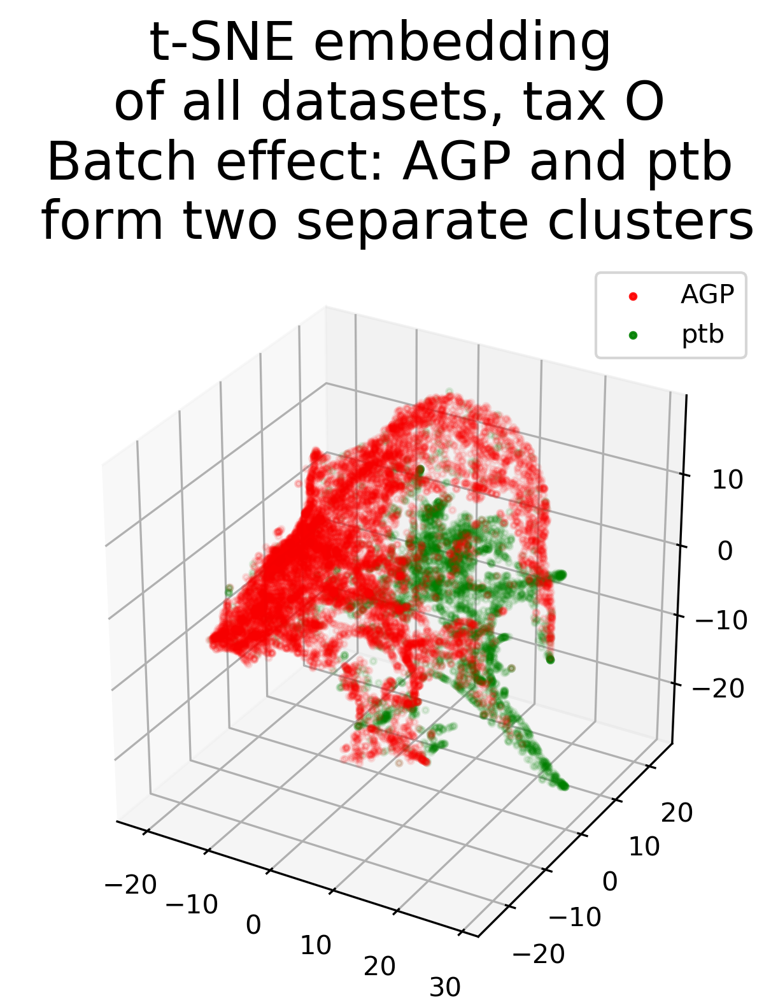

In [16]:
tax_name = 'O'
v = data_transformed3d_merged[f'proj_{tax_name.lower()}_tsne'] 
fig = plt.figure(figsize=(5,5), dpi=300)
ax = fig.add_subplot(1, 1, 1, projection='3d')
for dataset_name, dataset_color in color.items():
    if dataset_name in ['AGP', 'ptb']:
        mask = datasets_colors == dataset_color
        scatter = ax.scatter(v[:,0][mask], v[:,1][mask], v[:,2][mask], marker='.', alpha=0.1, color=dataset_color, label=dataset_name)
    ax.set_title(f't-SNE embedding \n of all datasets, tax {tax_name} \n Batch effect: AGP and ptb \n form two separate clusters', fontsize=20, pad=85)
    
#     handles, labels = scatter.legend_elements(alpha=0.8)
#     plt.legend(handles, labels, loc="upper right")

lgnd = plt.legend()
for lm in lgnd.legendHandles:
    lm.set_alpha(0.9)
# plt.show()
plt.savefig("./tsne.png", bbox_inches = 'tight',pad_inches = 0)

<IPython.core.display.Javascript object>


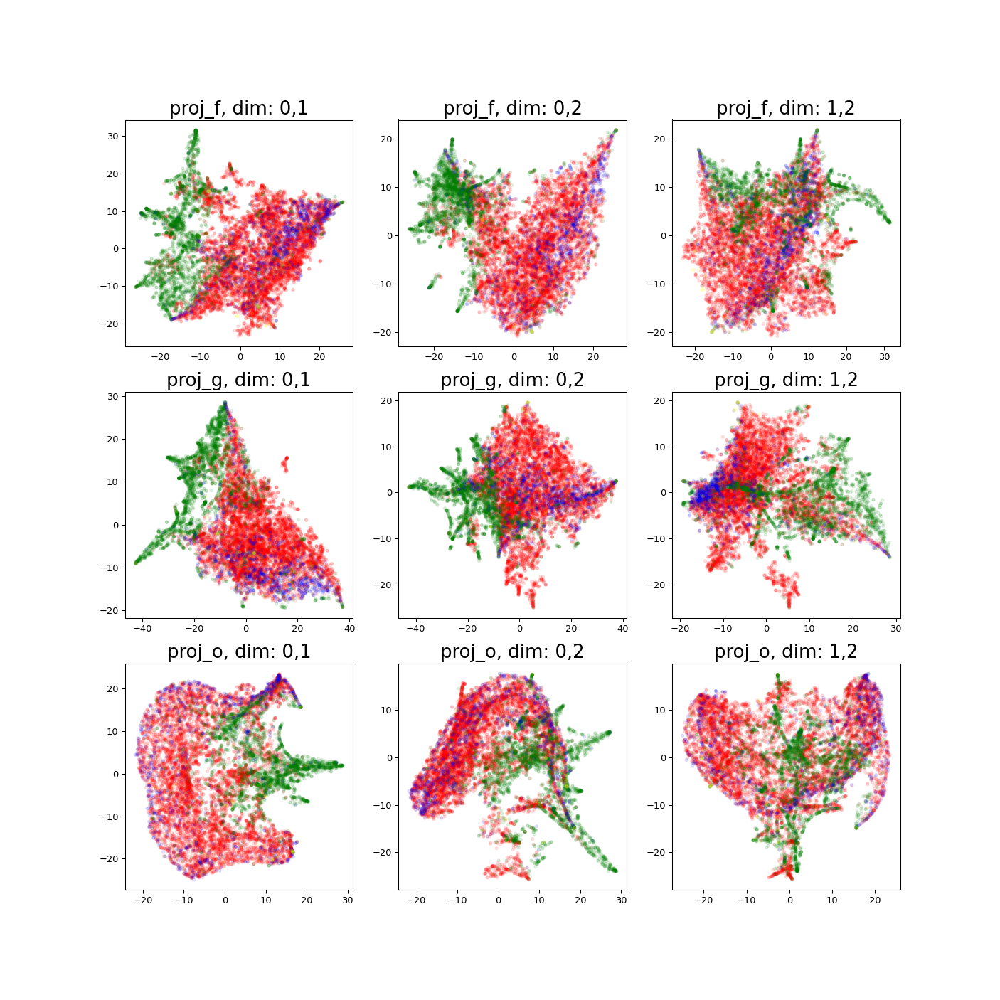

In [61]:
fig, ax = plt.subplots(ncols=3, nrows=3, figsize=(15,15))
for i,(k,v) in enumerate(data_transformed3d_merged.items()):
    for j,(d1,d2) in enumerate(combinations(range(3), 2)):
        ax[i,j].scatter(v[:,d1], v[:,d2], marker='.', alpha=0.1, c=datasets_colors)
        ax[i,j].set_title(f'{k}, dim: {d1},{d2}', fontsize=20)
#         fig.legend(color)
plt.show()

# Separate

In [16]:
root_separate = './separate_datasets_proj/'
paths_separate = [os.path.join(root_separate,path) for path in os.listdir(root_separate)]
label2path_separate = {}
datasets_separate = {}
for path in paths_separate:
    label = path.split('/')[-1].split('.')[0]
    label2path_separate[label] = path
    datasets_separate[label] = np.genfromtxt(path, delimiter=';')

In [13]:
# tsne3d = TSNE(n_components=3, init='pca', verbose=0, angle=0.3, perplexity=50, n_iter=5000, random_state=42)
# results3d_separate = Parallel(n_jobs=-1)(delayed(apply_tsne)(tsne3d, data) for _, data in datasets_separate.items())  

In [18]:
# data_transformed3d_separate = dict(zip(datasets_separate.keys(), [result[1] for result in results3d_separate]))

In [20]:
root_sep_trans = './separate_datasets_transformed/'
paths_tsne_separate = [os.path.join(root_sep_trans, path) for path in os.listdir(root_sep_trans)]
name = 'AGP_proj_o_tsne'
paths_tsne_separate = list(filter(lambda x: name in x.split('/')[-1].split('.')[0], paths_tsne_separate))
data_transformed3d_merged = { p.split('/')[-1].split('.')[0]:np.load(p, allow_pickle=True) for p in paths_tsne_separate}
v = data_transformed3d_merged[name]

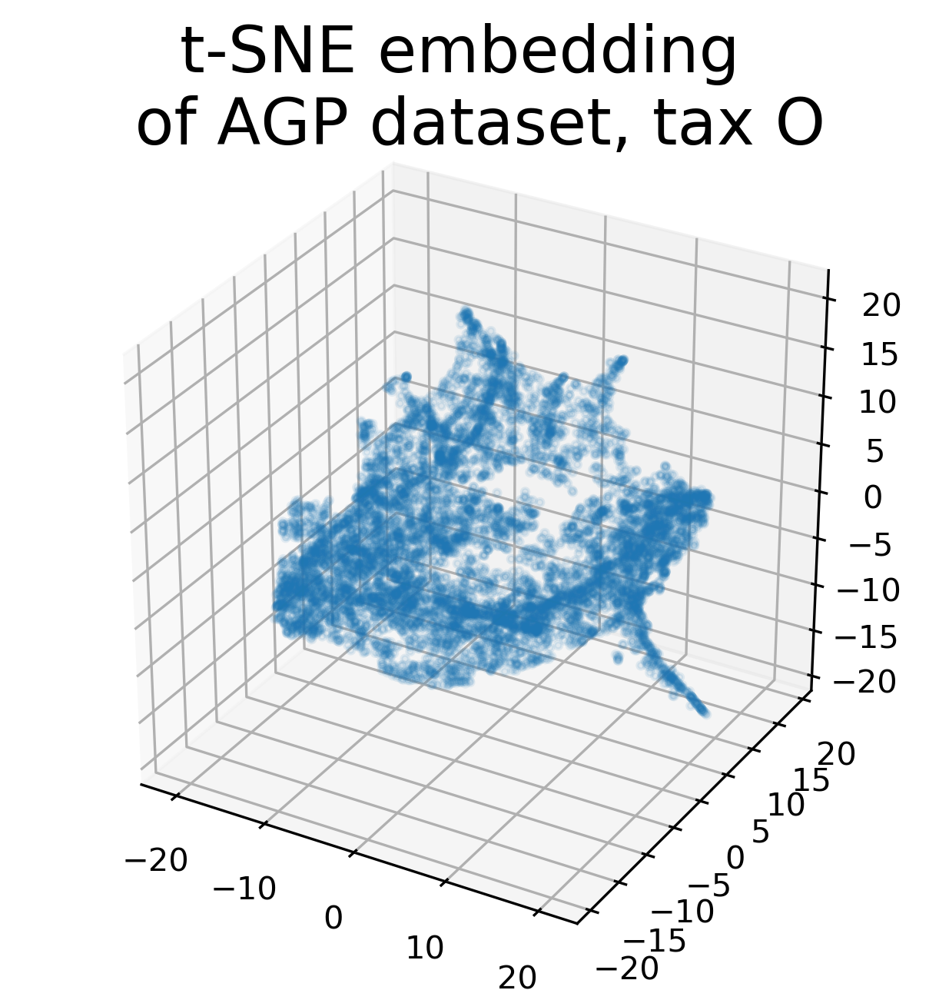

In [21]:
fig = plt.figure(figsize=(5,5), dpi=300)
ax = fig.add_subplot(1, 1, 1, projection='3d')
ax.scatter(v[:,0], v[:,1], v[:,2], marker='.', alpha=0.1)
ax.set_title(f't-SNE embedding \n of AGP dataset, tax O', fontsize=20, pad=10)
    
#     handles, labels = scatter.legend_elements(alpha=0.8)
#     plt.legend(handles, labels, loc="upper right")
# lgnd = plt.legend()
# for lm in lgnd.legendHandles:
#     lm.set_alpha(0.9)
plt.show()

In [23]:
# SAVE_SEPARATE = True

# if SAVE_SEPARATE:
#     for k,v in data_transformed3d_separate.items():
#         np.save(f'./separate_datasets_transformed/{k}_tsne3d', v)

In [28]:
fig = make_subplots(
    rows=4, 
    cols=3,
    specs=[[{'type': 'scene'}, {'type': 'scene'}, {'type': 'scene'}],
            [{'type': 'scene'}, {'type': 'scene'}, {'type': 'scene'}],
            [{'type': 'scene'}, {'type': 'scene'}, {'type': 'scene'}],
            [{'type': 'scene'}, {'type': 'scene'}, {'type': 'scene'}]])


for i,dataset_name in enumerate(['ptb', 'AGP', 't2d', 'ibd'], start=1):
    for j,tax_name in enumerate(['o', 'f', 'g'], start=1):

        label = '_'.join([dataset_name, 'proj', tax_name])
        data_trans = data_transformed3d_separate[label]
            
        x = data_trans[:,0] 
        y = data_trans[:,1]
        z = data_trans[:,2]
        # adding surfaces to subplots.
        fig.add_trace(
            go.Scatter3d(x=x, y=y, z=z, 
                        name=label,
                        text=dataset_names,
                        opacity=0.1, 
                        mode='markers', 
                        marker={'size':2,
                        'color':datasets_colors,
                        'line':{'width':0}}),
            row=i, 
            col=j)

fig.update_layout(
    title_text='TSNE',
    height=3200,
    width=2400
)

fig.show()

In [65]:
# tsne2d = TSNE(n_components=2, init='pca', verbose=0, angle=0.3, perplexity=50, n_iter=5000, random_state=42)
# results2d_separate = Parallel(n_jobs=-1)(delayed(apply_tsne)(tsne2d, data) for _, data in datasets_separate.items())  

In [66]:
# data_transformed2d_separate = dict(zip(datasets_separate.keys(), [result[1] for result in results2d_separate]))

In [67]:
# SAVE_SEPARATE = True
# if SAVE_SEPARATE:
#     for k,v in data_transformed2d_separate.items():
#         np.save(f'./separate_datasets_transformed/{k}_tsne2d', v)

In [82]:
# fig, ax = plt.subplots(ncols=3, nrows=3, figsize=(30,30))
# for i,dataset_name in enumerate(['ptb', 'AGP', 't2d'], start=0):
#     for j,tax_name in enumerate(['o', 'f', 'g'], start=0):
#         label = '_'.join([dataset_name, 'proj', tax_name])
#         v = data_transformed2d_separate[label]
#         ax[i,j].scatter(v[:,0], v[:,1], marker='.', alpha=0.2)
#         ax[i,j].set_title(f'{dataset_name}_{tax_name}', fontsize=20)
# #         ax[j,i].axis('off')

In [4]:
root_sep_trans = './separate_datasets_transformed/'
paths_tsne2d_separate = [os.path.join(root_sep_trans, path) for path in os.listdir(root_sep_trans)]
paths_tsne2d_separate = list(filter(lambda x: 'tsne2d' in x.split('/')[-1].split('.')[0], paths_tsne2d_separate))
data_transformed2d_separate = { p.split('/')[-1].split('.')[0]:np.load(p, allow_pickle=True) for p in paths_tsne2d_separate}

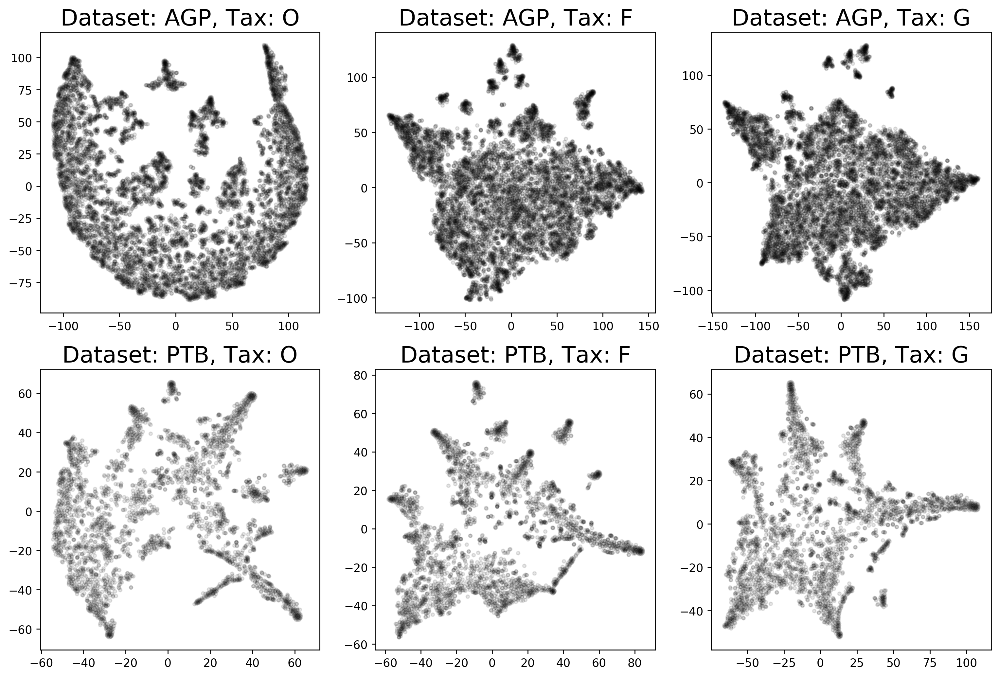

In [5]:
fig, ax = plt.subplots(ncols=3, nrows=2, figsize=(15,10), dpi=250)
for i,dataset_name in enumerate(['AGP', 'ptb'], start=0):
    for j,tax_name in enumerate(['o', 'f', 'g'], start=0):
        label = '_'.join([dataset_name, 'proj', tax_name, 'tsne2d'])
        v = data_transformed2d_separate[label]
        ax[i,j].scatter(v[:,0], v[:,1], marker='.', alpha=0.1, color='black')
        ax[i,j].set_title(f'Dataset: {dataset_name.upper()}, Tax: {tax_name.upper()}', fontsize=20)
plt.show()